**Functions**

In [ ]:
# Imports
import numpy as np
from bs4 import BeautifulSoup
import requests
import pandas as pd
import time
import matplotlib.pyplot as plt

get header is good now, extraneous but good for visibility.

In [ ]:
def get_offensive_stats_header(team_name, year):

  # firstly getting the url and full html

  url = f'https://www.sports-reference.com/cfb/schools/{str(team_name)}/{str(year)}/gamelog/'
  req = requests.get(url)
  html = req.text

  # now parsing the html into beautiful soup

  soup = BeautifulSoup(html, 'html.parser')

  #creating header list for df

  offensive_headers_list = []

# taking soup, getting the tr tag and cleaning up the text / extending cleaned list to offensive_headers_list

  for i in soup.findAll('tr'):
    offensive_headers_list.extend(i.text.replace('\n', ' ').split())
  
  offensive_headers_final = offensive_headers_list[8:33]

  # cleaning the headers / organizing them, creating extra variable here for readability

  offensive_headers_cleaned = offensive_headers_final
  for i in range(4, 9):
    offensive_headers_cleaned[i] = f'Passing_{offensive_headers_cleaned[i]}'
  for i in range(9, 13):
    offensive_headers_cleaned[i] = f'Rushing_{offensive_headers_cleaned[i]}'
  for i in range(13, 16):
    offensive_headers_cleaned[i] = f'Total_{offensive_headers_cleaned[i]}'
  for i in range(16, 20):
    offensive_headers_cleaned[i] = f'First_Downs_{offensive_headers_cleaned[i]}'
  for i in range(20, 22):
    offensive_headers_cleaned[i] = f'Penalties_{offensive_headers_cleaned[i]}'
  for i in range(22, 25):
    offensive_headers_cleaned[i] = f'Turnovers_{offensive_headers_cleaned[i]}'
  offensive_headers_cleaned.insert(2, "Location")
  offensive_headers_cleaned.append('Head_Coach')
  offensive_headers_cleaned.append('Conference')

  df_offensive = pd.DataFrame(columns=offensive_headers_cleaned)

  #done

  return df_offensive

In [ ]:
def get_offensive_stats(team_name, year):

  # firstly getting the url and full html

  url = f'https://www.sports-reference.com/cfb/schools/{str(team_name)}/{str(year)}/gamelog/'
  req = requests.get(url)
  html = req.text

  # now parsing the html into beautiful soup

  soup = BeautifulSoup(html, 'html.parser')

  # getting coach name and conference name

  coach_name = ''
  conference_name = ''

  for i in soup.find_all('strong'):
    if i.text == 'Coach:':
      coach_name = i.find_next('a').text


  for i in soup.find_all('strong'):
    if i.text == 'Conference:':
      conference_name = i.find_next('a').text
      

  #creating header list for df

  offensive_headers_list = []

# taking soup, getting the tr tag and cleaning up the text / extending cleaned list to offensive_headers_list

  for i in soup.findAll('tr'):
    offensive_headers_list.extend(i.text.replace('\n', ' ').split())
  
  offensive_headers_final = offensive_headers_list[8:33]

  # cleaning the headers / organizing them, creating extra variable here for readability

  offensive_headers_cleaned = offensive_headers_final
  for i in range(4, 9):
    offensive_headers_cleaned[i] = f'Passing_{offensive_headers_cleaned[i]}'
  for i in range(9, 13):
    offensive_headers_cleaned[i] = f'Rushing_{offensive_headers_cleaned[i]}'
  for i in range(13, 16):
    offensive_headers_cleaned[i] = f'Total_{offensive_headers_cleaned[i]}'
  for i in range(16, 20):
    offensive_headers_cleaned[i] = f'First_Downs_{offensive_headers_cleaned[i]}'
  for i in range(20, 22):
    offensive_headers_cleaned[i] = f'Penalties_{offensive_headers_cleaned[i]}'
  for i in range(22, 25):
    offensive_headers_cleaned[i] = f'Turnovers_{offensive_headers_cleaned[i]}'
  offensive_headers_cleaned.insert(2, "Location")

  # I need to break up the Result column into Result (W or L), points_scored, opp_points_scored

  df_offensive = pd.DataFrame(columns=offensive_headers_cleaned)

  # huge pain, this. The HTML for the site is structured funny; separating the table data by left and right.

  left_list = []
  right_list = []
  for i in soup.findAll('td', {'class': 'left '}):
    left_list.append(i.text)
  for i in soup.findAll('td'):
    string = str(i)
    if 'right' in string:
      right_list.append(i.text) 

  new_left_list = [];

  # the section below needs to be cleaned up; for whatever reason the count function struggled unless I explicitly laid out 
  # these if statements and created the redundant new_left_list

  for enum, item in enumerate(left_list):
    new_left_list.append(item)
    if(left_list[enum].count('-') == 2):
      # new_left_list.append(new_left_list[enum-1].count('-'))
      if left_list[enum+1] == '@':
        new_left_list.append('')
      elif left_list[enum+1] == 'N':
        new_left_list.append('')
      else:
        new_left_list.append('H')
  left_list = list(filter(None, new_left_list))
  left_list.pop()

  # this should probably be updated to be more dynamic, but for now it is what it is.

  left_index_counter = 0
  right_index_counter = 0
  rk = 1

  for enum, item in enumerate(left_list):
    if item.count('-') > 0 and item.count('(') > 0:
      data_list = []
      data_list.append(rk)
      rk += 1
      for i in range(left_index_counter, left_index_counter + 4):
        data_list.append(left_list[i])
      for i in range (right_index_counter, right_index_counter + 21):
        data_list.append(right_list[i])
      df_offensive.loc[len(df_offensive)] = data_list
      left_index_counter += 4
      right_index_counter += 21

  df_offensive['Head_Coach'] = coach_name
  df_offensive['Conference'] = conference_name


  return df_offensive


In [ ]:
def clean_df(football_df):
  df = football_df

  df.insert(5, 'Opp_Score', np.nan)
  df.insert(5, 'Team_Score', np.nan)
  df.insert(5, 'Game_Result', np.nan)

  for row in df.itertuples():
    index = int(row[0])
    result = str(row[5])
    slash = result.find('-')
    end_par = result.find(')')
    team_score = result[3:slash]
    opp_score = result[slash+1:end_par]

    df['Game_Result'] = df['Game_Result'].astype(str)
    df.at[index, 'Game_Result'] = result[0]
    df['Team_Score'] = df['Team_Score'].astype(str)
    df.at[index, 'Team_Score'] = team_score
    df['Opp_Score'] = df['Opp_Score'].astype(str)
    df.at[index, 'Opp_Score'] = opp_score

  df.drop('Result', axis=1, inplace=True)
  df = df.astype({'Team_Score': int, 'Opp_Score': int})
  return df

Running through all P5 teams and scraping into one dataframe

In [ ]:
# First 

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

df = get_offensive_stats_header('brigham-young', 2022)
df.head()

,Rk,Date,Location,Opponent,Result,Passing_Cmp,Passing_Att,Passing_Pct,Passing_Yds,Passing_TD,Rushing_Att,Rushing_Yds,Rushing_Avg,Rushing_TD,Total_Plays,Total_Yds,Total_Avg,First_Downs_Pass,First_Downs_Rush,First_Downs_Pen,First_Downs_Tot,Penalties_No.,Penalties_Yds,Turnovers_Fum,Turnovers_Int,Turnovers_Tot,Head_Coach,Conference


In [ ]:
teams_list = ['boston-college',	'illinois',	'baylor',	'arizona',	'alabama', 'clemson',	'indiana',	'iowa-state',
              'arizona-state',	'arkansas',
                'duke',	'iowa',	'kansas',	'california',	'auburn',
                'florida-state',	'maryland',	'kansas-state',	'ucla',	'florida',
                'georgia-tech',	'michigan',	'oklahoma-state',	'colorado',	'georgia',
                'louisville',	'michigan-state',	'texas-christian',	'oregon',	'kentucky',
                'miami-fl',	'minnesota', 'texas-tech',	'oregon-state', 	'louisiana-state',
                'north-carolina',	'nebraska',	'west-virginia',	'southern-california',	'mississippi',
                'north-carolina-state',	'northwestern',	'texas',	'stanford',	'mississippi-state',
                'pittsburgh',	'ohio-state',	'oklahoma',	'utah',	'missouri',
                'syracuse',	'penn-state',	'cincinnati',	'washington',	'south-carolina',
                'virginia',	'purdue',	'brigham-young',	'washington-state',	'tennessee',
                'virginia-tech',	'rutgers',	'houston',	'texas-am',
                'wake-forest',	'wisconsin',	'central-florida', 'vanderbilt',
                'notre-dame']
for team in teams_list:
  print(team)
  for i in range(2007, 2023):
    print(i)
    time.sleep(4)
    df2 = get_offensive_stats(team, i)
    df2['Team_Name'] = team
    df2['Year'] = i
    df = pd.concat([df, df2], axis=0)
df

boston-college
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
illinois
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
baylor
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
arizona
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
alabama
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
clemson
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
indiana
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
iowa-state
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
arizona-state
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
arkansas
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
duke
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
iowa
2007
2008
200

,Rk,Date,Location,Opponent,Result,Passing_Cmp,Passing_Att,Passing_Pct,Passing_Yds,Passing_TD,Rushing_Att,Rushing_Yds,Rushing_Avg,Rushing_TD,Total_Plays,Total_Yds,Total_Avg,First_Downs_Pass,First_Downs_Rush,First_Downs_Pen,First_Downs_Tot,Penalties_No.,Penalties_Yds,Turnovers_Fum,Turnovers_Int,Turnovers_Tot,Head_Coach,Conference,Team_Name,Year
0,1,2007-09-01,H,Wake Forest,W (38-28),32,52,61.5,408,5,27,54,2.0,0,79,462,5.8,21,2,1,24,6,45,1,2,3,Jeff Jagodzinski,ACC,boston-college,2007.0
1,2,2007-09-08,H,North Carolina State,W (37-17),15,34,44.1,142,1,39,231,5.9,3,73,373,5.1,8,10,1,19,5,40,0,1,1,Jeff Jagodzinski,ACC,boston-college,2007.0
2,3,2007-09-15,@,Georgia Tech,W (24-10),30,44,68.2,435,1,33,92,2.8,2,77,527,6.8,16,7,3,26,8,92,1,0,1,Jeff Jagodzinski,ACC,boston-college,2007.0
3,4,2007-09-22,H,Army,W (37-17),36,53,67.9,371,3,37,202,5.5,2,90,573,6.4,19,12,3,34,4,30,1,2,3,Jeff Jagodzinski,ACC,boston-college,2007.0
4,5,2007-09-29,H,Massachusetts,W (24-14),24,42,57.1,204,1,37,119,3.2,2,79,323,4.1,12,9,5,26,9,65,0,0,0,Jeff Jagodzinski,ACC,boston-college,2007.0
5,6,2007-10-06,H,Bowling Green State,W (55-24),25,34,73.5,325,4,35,146,4.2,1,69,471,6.8,12,13,1,26,3,33,1,0,1,Jeff Jagodzinski,ACC,boston-college,2007.0
6,7,2007-10-13,@,Notre Dame,W (27-14),32,49,65.3,291,2,34,168,4.9,2,83,459,5.5,15,5,1,21,15,131,0,1,1,Jeff Jagodzinski,ACC,boston-college,2007.0
7,8,2007-10-25,@,Virginia Tech,W (14-10),25,53,47.2,285,2,18,32,1.8,0,71,317,4.5,14,3,2,19,9,83,0,2,2,Jeff Jagodzinski,ACC,boston-college,2007.0
8,9,2007-11-03,H,Florida State,L (17-27),26,53,49.1,415,2,21,63,3.0,0,74,478,6.5,14,5,1,20,8,121,1,3,4,Jeff Jagodzinski,ACC,boston-college,2007.0
9,10,2007-11-10,@,Maryland,L (35-42),33,56,58.9,421,3,27,45,1.7,2,83,466,5.6,23,2,2,27,6,45,0,2,2,Jeff Jagodzinski,ACC,boston-college,2007.0


In [ ]:
df.head()

,Rk,Date,Location,Opponent,Result,Passing_Cmp,Passing_Att,Passing_Pct,Passing_Yds,Passing_TD,Rushing_Att,Rushing_Yds,Rushing_Avg,Rushing_TD,Total_Plays,Total_Yds,Total_Avg,First_Downs_Pass,First_Downs_Rush,First_Downs_Pen,First_Downs_Tot,Penalties_No.,Penalties_Yds,Turnovers_Fum,Turnovers_Int,Turnovers_Tot,Head_Coach,Conference,Team_Name,Year
0,1,2007-09-01,H,Wake Forest,W (38-28),32,52,61.5,408,5,27,54,2.0,0,79,462,5.8,21,2,1,24,6,45,1,2,3,Jeff Jagodzinski,ACC,boston-college,2007.0
1,2,2007-09-08,H,North Carolina State,W (37-17),15,34,44.1,142,1,39,231,5.9,3,73,373,5.1,8,10,1,19,5,40,0,1,1,Jeff Jagodzinski,ACC,boston-college,2007.0
2,3,2007-09-15,@,Georgia Tech,W (24-10),30,44,68.2,435,1,33,92,2.8,2,77,527,6.8,16,7,3,26,8,92,1,0,1,Jeff Jagodzinski,ACC,boston-college,2007.0
3,4,2007-09-22,H,Army,W (37-17),36,53,67.9,371,3,37,202,5.5,2,90,573,6.4,19,12,3,34,4,30,1,2,3,Jeff Jagodzinski,ACC,boston-college,2007.0
4,5,2007-09-29,H,Massachusetts,W (24-14),24,42,57.1,204,1,37,119,3.2,2,79,323,4.1,12,9,5,26,9,65,0,0,0,Jeff Jagodzinski,ACC,boston-college,2007.0


In [ ]:
df.shape

(13862, 30)

Outputting into a csv

In [ ]:
df.to_csv('jeffrey_football.csv', index=False)

To save time and from scraping the site too many times (this took about 2.5 hours to scrape just 15 years), I uploaded the csv to the cloud to access directly for imports into this and future projects.

In [ ]:
df_final = pd.read_csv('https://byu.box.com/shared/static/8arjj9k9sijfz8f93gqle5ig0lmsxxxl.csv')

df_final = clean_df(df_final)

df_final.head()

,Rk,Date,Location,Opponent,Game_Result,Team_Score,Opp_Score,Passing_Cmp,Passing_Att,Passing_Pct,Passing_Yds,Passing_TD,Rushing_Att,Rushing_Yds,Rushing_Avg,Rushing_TD,Total_Plays,Total_Yds,Total_Avg,First_Downs_Pass,First_Downs_Rush,First_Downs_Pen,First_Downs_Tot,Penalties_No.,Penalties_Yds,Turnovers_Fum,Turnovers_Int,Turnovers_Tot,Head_Coach,Conference,Team_Name,Year
0,1,9/1/2007,H,Wake Forest,W,38,28,32,52,61.5,408,5,27,54,2.0,0,79,462,5.8,21,2,1,24,6,45,1,2,3,Jeff Jagodzinski,ACC,boston-college,2007
1,2,9/8/2007,H,North Carolina State,W,37,17,15,34,44.1,142,1,39,231,5.9,3,73,373,5.1,8,10,1,19,5,40,0,1,1,Jeff Jagodzinski,ACC,boston-college,2007
2,3,9/15/2007,@,Georgia Tech,W,24,10,30,44,68.2,435,1,33,92,2.8,2,77,527,6.8,16,7,3,26,8,92,1,0,1,Jeff Jagodzinski,ACC,boston-college,2007
3,4,9/22/2007,H,Army,W,37,17,36,53,67.9,371,3,37,202,5.5,2,90,573,6.4,19,12,3,34,4,30,1,2,3,Jeff Jagodzinski,ACC,boston-college,2007
4,5,9/29/2007,H,Massachusetts,W,24,14,24,42,57.1,204,1,37,119,3.2,2,79,323,4.1,12,9,5,26,9,65,0,0,0,Jeff Jagodzinski,ACC,boston-college,2007


In [ ]:
df_coach_record = pd.DataFrame(df_final['Head_Coach'].unique(), columns = ['Head_Coach'])

df_coach_record.shape

(198, 1)

In [ ]:
coach_list = df_coach_record['Head_Coach'].tolist()
wins_list = []
losses_list = []

for coach in coach_list:
  wins_total = len(df_final.loc[(df_final['Head_Coach'] == coach) & (df_final['Game_Result'] == 'W')])
  wins_list.append(wins_total)
  losses_total = len(df_final.loc[(df_final['Head_Coach'] == coach) & (df_final['Game_Result'] == 'L')])
  losses_list.append(losses_total)
df_coach_record['Wins'] = wins_list
df_coach_record['Losses'] = losses_list

df_coach_record.head()

,Head_Coach,Wins,Losses
0,Jeff Jagodzinski,20,8
1,Frank Spaziani,21,29
2,Steve Addazio,44,45
3,Jeff Hafley,15,20
4,Ron Zook,31,32


In [ ]:
df_coach_record = df_coach_record.sort_values(by=['Wins'], ascending=False)

df_coach_record.head()

,Head_Coach,Wins,Losses
18,Nick Saban,193,27
20,Dabo Swinney,157,35
112,Brian Kelly,155,52
78,Mike Gundy,145,61
145,Kyle Whittingham,138,63


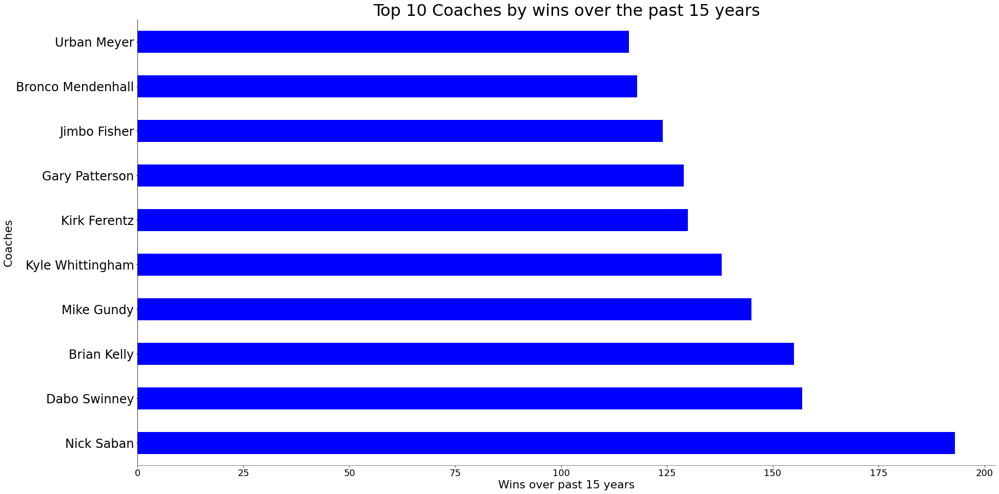

In [ ]:
no_losses = df_coach_record.copy()
no_losses.drop(columns=['Losses'], inplace=True)
ind = no_losses.set_index("Head_Coach", inplace = True)

barh = no_losses.head(10).plot(kind='barh',figsize=(30, 16), color = "blue", legend = None)
barh
plt.yticks(fontsize = 24)
plt.xticks(ind, fontsize = 18)
plt.xlabel("Wins since 2007", fontsize = 22)
plt.ylabel("Coaches", fontsize = 22)
plt.title("Top 10 Coaches by wins over the past 15 years", fontsize=32)
barh.spines['top'].set_visible(False)
barh.spines['right'].set_visible(False)
barh.spines['bottom'].set_linewidth(0.5)
barh.spines['left'].set_visible(True)
plt.show()

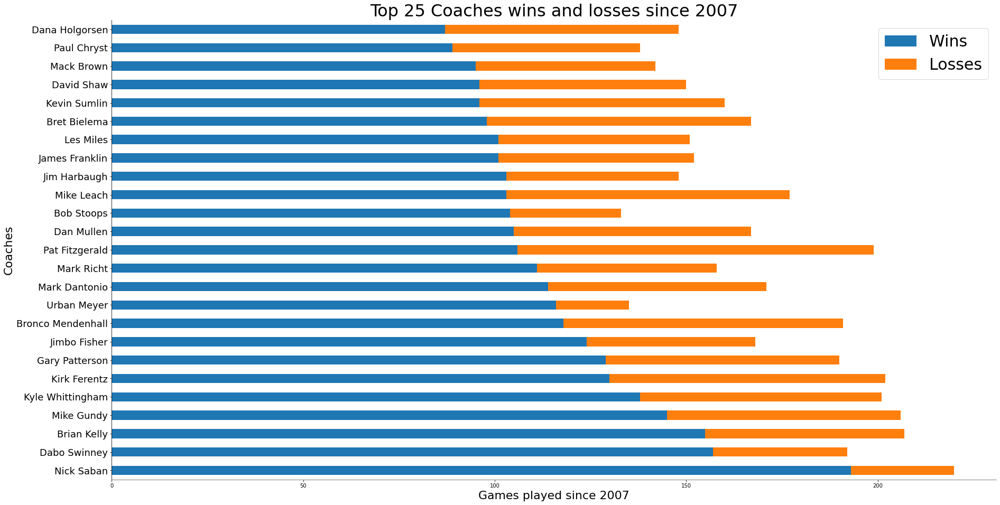

In [ ]:
df_record = df_coach_record.copy()
barh = df_record.head(25).plot(x = "Head_Coach", y = ['Wins', 'Losses'], kind='barh', stacked = True, figsize=(30, 16))
barh

plt.legend(loc="upper right", prop={'size': 30})
plt.yticks(fontsize = 18)
plt.xlabel("Games played since 2007", fontsize = 22)
plt.ylabel("Coaches", fontsize = 22)
plt.title("Top 25 Coaches wins and losses since 2007", fontsize=32)
barh.spines['top'].set_visible(False)
barh.spines['right'].set_visible(False)
barh.spines['bottom'].set_linewidth(0.5)
barh.spines['left'].set_visible(True)
plt.show()